In [1]:
%pylab inline

%pylab is deprecated, use %matplotlib inline and import the required libraries.
Populating the interactive namespace from numpy and matplotlib


In [49]:
import numpy as np
from numpy import linspace, sin, cos
from copy import copy
import matplotlib.pyplot as plt
from celluloid import Camera
from IPython.display import HTML





def simulate(Δt, x, u, l1, l2, m1, m2):
    θ1, θ2, θ1_dot, θ2_dot = x
    
    M = np.array([
        [l1**2 * (m1 + m2) + 2 * l1 * l2 * m2 * cos(θ2) + l2**2 * m2, l2 * m2 * (l1 * cos(θ2) + l2)],
        [l2 * m2 * (l1 * cos(θ2) + l2), l2**2 * m2]
    ])
    
    θ_ddot = np.linalg.inv(M).dot(u * np.array([0, 1]))
    
    if x[0] + x[1] <= -np.pi/2:
        θ_ddot[1] = -θ_ddot[1]
        print(x[0] + x[1])
        
    x += Δt * np.concatenate((x[2:], θ_ddot))
    return x

# Parameters
l1, l2 = 2, 1     # Lengths of the pendulum arms
m1, m2 = 1, 1     # Masses
g = 9.8           # Gravity

# Time settings
tf = 6.
Δt = 0.1    # Time step
time = np.linspace(0., tf, int(tf / Δt) + 1)  # Time interval

# Initial conditions
#θ1, θ2, θ1_dot, θ2_dot = 0.2, np.pi/4, 0, 0
θ1, θ2, θ1_dot, θ2_dot = np.pi/2, -np.pi*2/3, 0, -0.
x = np.array([θ1, θ2, θ1_dot, θ2_dot])
x_log = [copy(x)]

for t in time[1:]:
    # Control input
    u = 0.05

    # Simulate
    x = simulate(Δt, x, u, l1, l2/2, m1, m2)
    x_log.append(copy(x))

x_log = np.array(x_log)


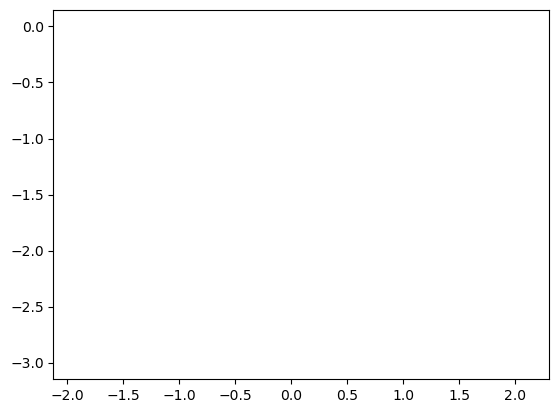

In [48]:
# Visualization using celluloid
fig, ax = plt.subplots()
camera = Camera(fig)

ax.set_xlim(-2 * (l1 + l2/2), 2 * (l1 + l2/2))
ax.set_ylim(-2 * (l1 + l2/2), 2 * (l1 + l2/2))

for frame in x_log:
    θ1, θ2, _, _ = frame
    x1, y1 = l1 * cos(θ1), -l1 * sin(θ1)
    x2, y2 = x1 + l2 * cos(θ1 + θ2), y1 - l2 * sin(θ1 + θ2)
    ax.plot([0, x1, x2], [0, y1, y2], 'ro-', lw=2)
    
    # Add the values of theta 1 and theta 2 as text
    text_x, text_y = -2 * (l1 + l2/2) * 0.9, 2 * (l1 + l2/2) * 0.9
    ax.text(0, 0, f"θ1: {θ1:.2f}, θ2: {θ2:.2f}", fontsize=12)
    
    # Draw the arrow at the midpoint of the second pendulum arm
    arrow_x, arrow_y = (x1 + x2) / 2, (y1 + y2) / 2
    ax.quiver(arrow_x, arrow_y, -sin(θ1 + θ2), -cos(θ2 + θ1), angles='xy', scale_units='xy', scale=2, color='blue')
    ax.axis('equal')
    camera.snap()

animation = camera.animate()

display(HTML(animation.to_jshtml()))

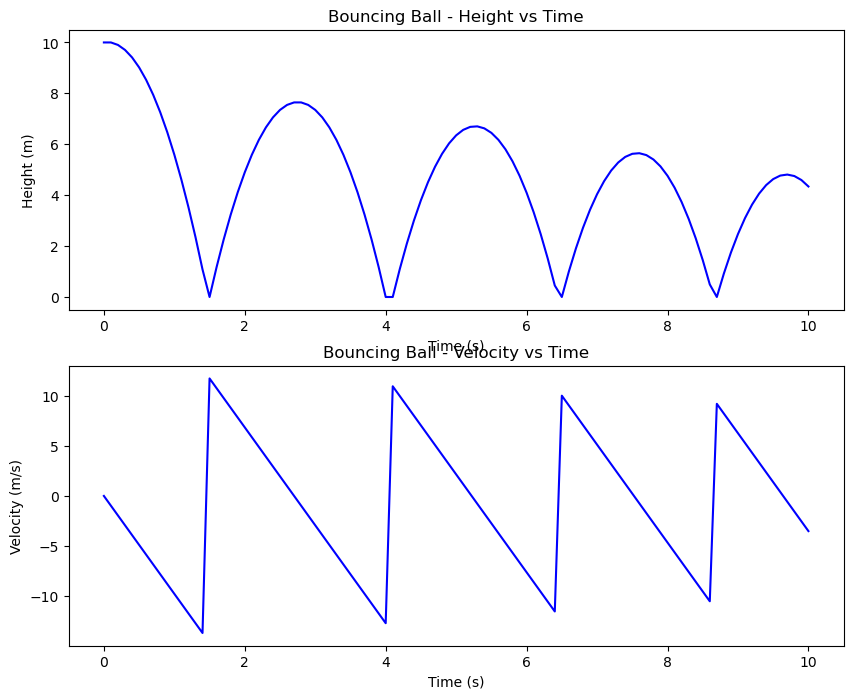

In [3]:
import numpy as np
import matplotlib.pyplot as plt
from celluloid import Camera
from IPython.display import HTML

def simulate(Δt, x, g, e):
    y, v = x
    y += v * Δt
    v -= g * Δt

    if y <= 0:
        y = 0
        v = -e * v

    return np.array([y, v])

# Parameters
g = 9.8    # Acceleration due to gravity (m/s^2)
e = 0.8    # Coefficient of restitution

# Time settings
tf = 10.
Δt = 0.1    # Time step
time = np.linspace(0., tf, int(tf / Δt) + 1)  # Time interval

# Initial conditions
y0, v0 = 10, 0    # Initial height (m) and velocity (m/s)
x = np.array([y0, v0])
x_log = [x]

for t in time[1:]:
    # Simulate
    x = simulate(Δt, x, g, e)
    x_log.append(x)

x_log = np.array(x_log)

# Plotting
fig, ax = plt.subplots(2, 1, figsize=(10, 8))
camera = Camera(fig)

for i in range(len(time)):
    ax[0].plot(time[:i+1], x_log[:i+1, 0], 'b')
    ax[0].set_xlabel('Time (s)')
    ax[0].set_ylabel('Height (m)')
    ax[0].set_title('Bouncing Ball - Height vs Time')

    ax[1].plot(time[:i+1], x_log[:i+1, 1], 'b')
    ax[1].set_xlabel('Time (s)')
    ax[1].set_ylabel('Velocity (m/s)')
    ax[1].set_title('Bouncing Ball - Velocity vs Time')

    camera.snap()

animation = camera.animate(interval=100, blit=True)
display(HTML(animation.to_jshtml()))

# If you want to save the animation as a file, uncomment the following line:
# animation.save('bouncing_ball.mp4')


In [92]:
import numpy as np
from numpy import linspace, sin, cos
from copy import copy
import matplotlib.pyplot as plt
from celluloid import Camera
from IPython.display import HTML





def simulate(Δt, x, u, l1, l2, m1, m2):
    θ1, θ2, θ1_dot, θ2_dot = x
    
    
    M = np.array([
        [l1**2 * (m1 + m2) + 2 * l1 * l2 * m2 * cos(θ2) + l2**2 * m2, 
         l2 * m2 * (l1 * cos(θ2) + l2)],
        [l2 * m2 * (l1 * cos(θ2) + l2), 
         l2**2 * m2]
    ])
    
    θ_ddot = np.linalg.inv(M).dot(u * np.array([0, 1]))
    
    
        
    x += Δt * np.concatenate((x[2:], θ_ddot))

    if x[1] - x[0] > -np.pi:
        x[3] = -C * x[3]
        
    return x

# Parameters
l1, l2 = 2, 1     # Lengths of the pendulum arms
m1, m2 = 1, 1     # Masses
g = 9.8           # Gravity
C = 0.8           # Damping term

# Time settings
tf = 12.
Δt = 0.1    # Time step
time = np.linspace(0., tf, int(tf / Δt) + 1)  # Time interval

# Initial conditions
#θ1, θ2, θ1_dot, θ2_dot = 0.2, np.pi/4, 0, 0
θ1, θ2, θ1_dot, θ2_dot = np.pi/2, -np.pi*2/3, 0, -0.
x = np.array([θ1, θ2, θ1_dot, θ2_dot])
x_log = [copy(x)]

for t in time[1:]:
    # Control input
    u = 0.05

    # Simulate
    x = simulate(Δt, x, u, l1, l2/2, m1, m2)
    x_log.append(copy(x))

x_log = np.array(x_log)


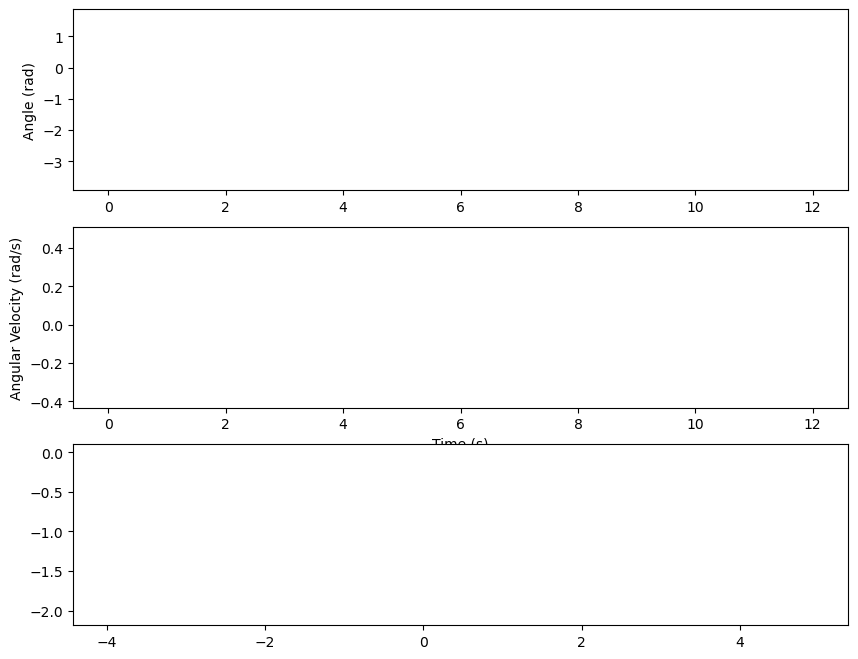

In [93]:
# Visualization using celluloid

fig, ax = plt.subplots(3, 1, figsize=(10, 8))
camera = Camera(fig)

ax[2].set_xlim(-2 * (l1 + l2/2), 2 * (l1 + l2/2))
ax[2].set_ylim(-2 * (l1 + l2/2), 2 * (l1 + l2/2))

for i in range(len(time)):
    θ1, θ2, θ1_dot, θ2_dot = x_log[i]
    x1, y1 = l1 * cos(θ1), -l1 * sin(θ1)
    x2, y2 = x1 + l2 * cos(θ1 + θ2), y1 - l2 * sin(θ1 + θ2)
    
    # Draw the angle and angular velocity
    ax[0].plot(time[:i+1], x_log[:i+1, 0], 'b')
    ax[0].plot(time[:i+1], x_log[:i+1, 1] - x_log[:i+1, 0], 'r')
    ax[0].set_ylabel('Angle (rad)')


    ax[1].plot(time[:i+1], x_log[:i+1, 2], 'b')
    ax[1].plot(time[:i+1], x_log[:i+1, 3], 'r')
    ax[1].set_xlabel('Time (s)')
    ax[1].set_ylabel('Angular Velocity (rad/s)')

    
    # Add the values of theta 1 and theta 2 as text
    ax[2].text(0, 0, f"θ1: {θ1*180/3.14:.2f}, θ2: {(θ2 - θ1)*180/3.14:.2f}", fontsize=12)
    
    # Draw the arrow at the midpoint of the second pendulum arm
    arrow_x, arrow_y = (x1 + x2) / 2, (y1 + y2) / 2
    ax[2].quiver(arrow_x, arrow_y, -sin(θ1 + θ2), -cos(θ2 + θ1), angles='xy', scale_units='xy', scale=2, color='blue')
    ax[2].plot([0, x1, x2], [0, y1, y2], 'ro-', lw=2)

    ax[2].axis('equal')
    camera.snap()

animation = camera.animate()

display(HTML(animation.to_jshtml()))

In [94]:
import numpy as np
from numpy import linspace, sin, cos
from copy import copy
import matplotlib.pyplot as plt
from celluloid import Camera
from IPython.display import HTML





def simulate(Δt, x, u, l1, l2, m1, m2):
    θ1, θ2, θ1_dot, θ2_dot = x
    
    
    M = np.array([
        [l1**2 * (m1 + m2), 
         l1 * l2 * m2 * cos(θ1 - θ2)],
        [l1 * l2 * m2 * (cos(θ1 - θ2)), 
         l2**2 * m2]
    ])
    
    θ_ddot = np.linalg.inv(M).dot(u * np.array([0, 1]))
    
    
        
    x += Δt * np.concatenate((x[2:], θ_ddot))

    if x[1] > 0:
#         θ2 = -np.pi/2
        x[3] = -C * x[3]
        

    return x

# Parameters
l1, l2 = 2, 1     # Lengths of the pendulum arms
m1, m2 = 1, 1     # Masses
g = 9.8           # Gravity
C = 0.8           # Damping term

# Time settings
tf = 10.
Δt = 0.1    # Time step
time = np.linspace(0., tf, int(tf / Δt) + 1)  # Time interval

# Initial conditions
#θ1, θ2, θ1_dot, θ2_dot = 0.2, np.pi/4, 0, 0
θ1, θ2, θ1_dot, θ2_dot = np.pi/2 - np.pi/3, -0.1, 0, -0.
x = np.array([θ1, θ2, θ1_dot, θ2_dot])
x_log = [copy(x)]

for t in time[1:]:
    # Control input
    u = 0.05

    # Simulate
    x = simulate(Δt, x, u, l1, l2/2, m1, m2)
    x_log.append(copy(x))

x_log = np.array(x_log)


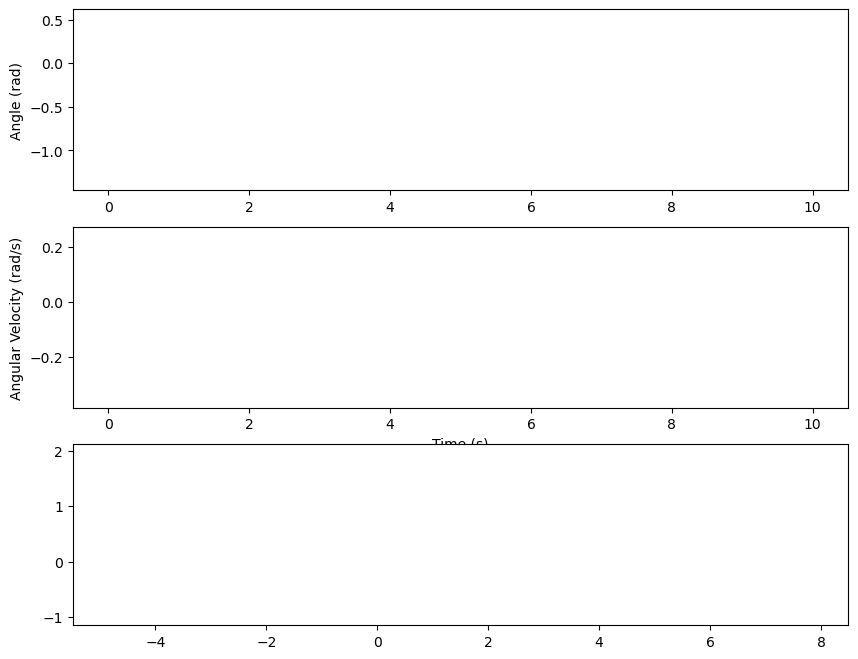

In [95]:
# Visualization using celluloid

fig, ax = plt.subplots(3, 1, figsize=(10, 8))
camera = Camera(fig)

ax[2].set_xlim(-2 * (l1 + l2/2), 2 * (l1 + l2/2))
ax[2].set_ylim(-2 * (l1 + l2/2), 2 * (l1 + l2/2))

for i in range(len(time)):
    θ1, θ2, θ1_dot, θ2_dot = x_log[i]
    x1, y1 = l1 * cos(θ1), -l1 * sin(θ1)
    x2, y2 = x1 + l2 * cos(θ2), y1 - l2 * sin(θ2)
    
    # Draw the angle and angular velocity
    ax[0].plot(time[:i+1], x_log[:i+1, 0], 'b')
    ax[0].plot(time[:i+1], x_log[:i+1, 1], 'r')
    ax[0].set_ylabel('Angle (rad)')

    ax[1].plot(time[:i+1], x_log[:i+1, 2], 'b')
    ax[1].plot(time[:i+1], x_log[:i+1, 3], 'r')
    ax[1].set_xlabel('Time (s)')
    ax[1].set_ylabel('Angular Velocity (rad/s)')

    
    # Add the values of theta 1 and theta 2 as text
    ax[2].text(0, 0, f"θ1: {θ1*180/3.14:.2f}, θ2: {θ2*180/3.14:.2f}", fontsize=12)
    
    # Draw the arrow at the midpoint of the second pendulum arm
    arrow_x, arrow_y = (x1 + x2) / 2, (y1 + y2) / 2
    ax[2].quiver(arrow_x, arrow_y, -sin(θ2), -cos(θ2), angles='xy', scale_units='xy', scale=2, color='blue')
    ax[2].plot([0, x1, x2], [0, y1, y2], 'ro-', lw=2)

    ax[2].axis('equal')
    camera.snap()

animation = camera.animate()

display(HTML(animation.to_jshtml()))

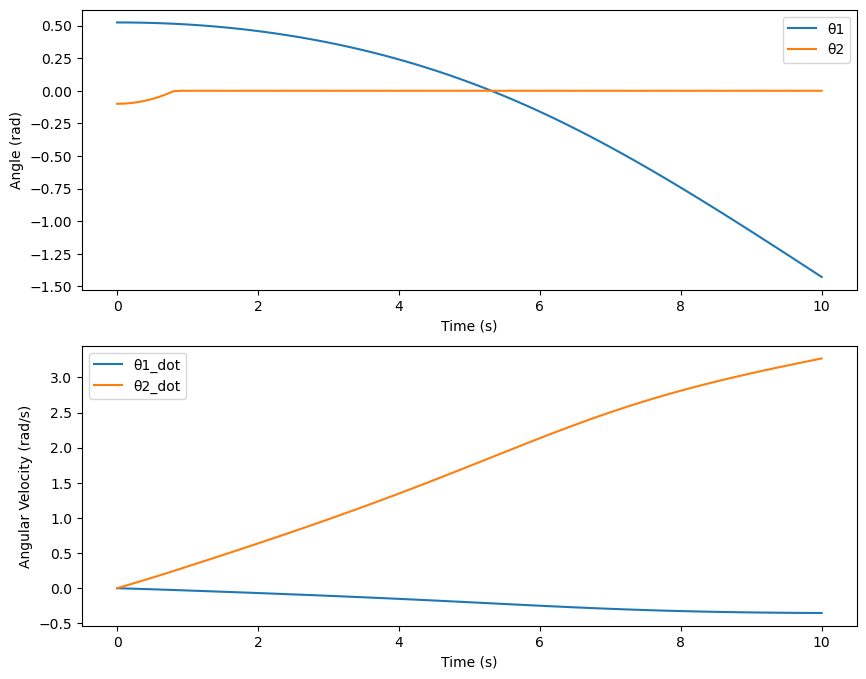

In [91]:
import numpy as np
from scipy.integrate import solve_ivp
import matplotlib.pyplot as plt
from celluloid import Camera
from IPython.display import HTML

def dynamics(t, x, u, l1, l2, m1, m2, C):
    θ1, θ2, θ1_dot, θ2_dot = x
    M = np.array([
        [l1**2 * (m1 + m2), l1 * l2 * m2 * cos(θ1 - θ2)],
        [l1 * l2 * m2 * cos(θ1 - θ2), l2**2 * m2]
    ])
    θ_ddot = np.linalg.inv(M).dot(u * np.array([0, 1]))
    
    if θ2 > 0:
        θ2_dot = -C * θ2_dot

    return [θ1_dot, θ2_dot, θ_ddot[0], θ_ddot[1]]

def simulate(t_span, x0, u, l1, l2, m1, m2, C):
    sol = solve_ivp(dynamics, t_span, x0, args=(u, l1, l2, m1, m2, C), dense_output=True)
    return sol

# Parameters
l1, l2 = 2, 1     # Lengths of the pendulum arms
m1, m2 = 1, 1     # Masses
g = 9.8           # Gravity
C = 1           # Damping term

# Time settings
tf = 10.
Δt = 0.1    # Time step
time = np.linspace(0., tf, int(tf / Δt) + 1)  # Time interval

# Initial conditions
θ1, θ2, θ1_dot, θ2_dot = np.pi/2 - np.pi/3, -0.1, 0, -0.
x0 = [θ1, θ2, θ1_dot, θ2_dot]

# Control input
u = 0.05

# Simulate
sol = simulate((0, tf), x0, u, l1, l2/2, m1, m2, C)
x_log = sol.sol(time).T

# Plotting
fig, ax = plt.subplots(2, 1, figsize=(10, 8))
camera = Camera(fig)

# for i in range(len(time)):
ax[0].plot(time, x_log[:, 0], label='θ1')
ax[0].plot(time, x_log[:, 1], label='θ2')
ax[0].set_xlabel('Time (s)')
ax[0].set_ylabel('Angle (rad)')
ax[0].legend()

ax[1].plot(time, x_log[:, 2], label='θ1_dot')
ax[1].plot(time, x_log[:, 3], label='θ2_dot')
ax[1].set_xlabel('Time (s)')
ax[1].set_ylabel('Angular Velocity (rad/s)')
ax[1].legend()

#     camera.snap()

# animation = camera.animate(interval=100, blit=True)
# HTML(animation.to_html5_video())

# If you want to save the animation as a file, uncomment the following line:
# animation.save('pendulum_simulation.mp4')


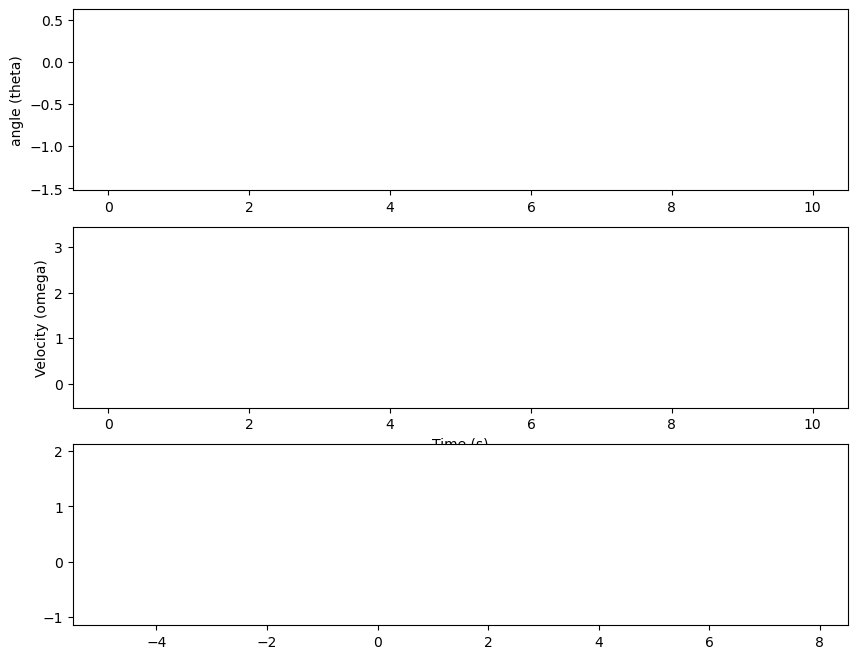

In [90]:
# Visualization using celluloid

fig, ax = plt.subplots(3, 1, figsize=(10, 8))
camera = Camera(fig)

ax[2].set_xlim(-2 * (l1 + l2/2), 2 * (l1 + l2/2))
ax[2].set_ylim(-2 * (l1 + l2/2), 2 * (l1 + l2/2))

for i in range(len(time)):
    θ1, θ2, θ1_dot, θ2_dot = x_log[i]
    x1, y1 = l1 * cos(θ1), -l1 * sin(θ1)
    x2, y2 = x1 + l2 * cos(θ2), y1 - l2 * sin(θ2)
    
    # Draw the angle and angular velocity
    ax[0].plot(time[:i+1], x_log[:i+1, 0], 'b')
    ax[0].plot(time[:i+1], x_log[:i+1, 1], 'r')
    ax[0].set_ylabel('Angle (rad)')

    ax[1].plot(time[:i+1], x_log[:i+1, 2], 'b')
    ax[1].plot(time[:i+1], x_log[:i+1, 3], 'r')
    ax[1].set_xlabel('Time (s)')
    ax[1].set_ylabel('Angular Velocity (rad/s)')

    
    # Add the values of theta 1 and theta 2 as text
    ax[2].text(0, 0, f"θ1: {θ1*180/3.14:.2f}, θ2: {θ2*180/3.14:.2f}", fontsize=12)
    
    # Draw the arrow at the midpoint of the second pendulum arm
    arrow_x, arrow_y = (x1 + x2) / 2, (y1 + y2) / 2
    ax[2].quiver(arrow_x, arrow_y, -sin(θ2), -cos(θ2), angles='xy', scale_units='xy', scale=2, color='blue')
    ax[2].plot([0, x1, x2], [0, y1, y2], 'ro-', lw=2)

    ax[2].axis('equal')
    camera.snap()

animation = camera.animate()

display(HTML(animation.to_jshtml()))

In [106]:
import numpy as np
from numpy import linspace, sin, cos
from copy import copy
import matplotlib.pyplot as plt
from celluloid import Camera
from IPython.display import HTML


def check_leght(l,x_start,y_start,x_end,y_end):
    return l > np.linalg.norm([[x_start,y_start],[x_end,y_end]])
    

def simulate(Δt, x, u, l1, l2, m1, m2):
    θ1, θ2, θ1_dot, θ2_dot = x
    
    
    M = np.array([
        [l1**2 * (m1 + m2), 
         l1 * l2 * m2 * cos(θ1 - θ2)],
        [l1 * l2 * m2 * (cos(θ1 - θ2)), 
         l2**2 * m2]
    ])
    
    θ_ddot = np.linalg.inv(M).dot(u * np.array([0, 1]))
    
    
        
    x += Δt * np.concatenate((x[2:], θ_ddot))
    
    x1, y1 = l1 * cos(x[0]), -l1 * sin(x[0])
    x2, y2 = x1 + l2 * cos(x[1]), y1 - l2 * sin(x[1])
    
    
    print(np.linalg.norm([[1,0],[x2,y2]]))
    
    if l1 > np.linalg.norm([[1,0],[x2,y2]]):
        x[3] = -C * x[3]
        print("here")
        

    return x

# Parameters
l1, l2 = 2, 1     # Lengths of the pendulum arms
m1, m2 = 1, 1     # Masses
g = 9.8           # Gravity
C = 0.8           # Damping term

# Time settings
tf = 10.
Δt = 0.1    # Time step
time = np.linspace(0., tf, int(tf / Δt) + 1)  # Time interval

# Initial conditions
#θ1, θ2, θ1_dot, θ2_dot = 0.2, np.pi/4, 0, 0
θ1, θ2, θ1_dot, θ2_dot = np.pi/2 - np.pi/3, -0.1, 0, -0.
x = np.array([θ1, θ2, θ1_dot, θ2_dot])
x_log = [copy(x)]

for t in time[1:]:
    # Control input
    u = 0.05

    # Simulate
    x = simulate(Δt, x, u, l1, l2/2, m1, m2)
    x_log.append(copy(x))

x_log = np.array(x_log)



2.621748338677336
2.6224783675764507
2.623927765888777
2.62607694864015
2.6288970913515755
2.6323496226166463
2.636385517504067
2.6409443830665222
2.6459533251046596
2.6513255846847015
2.6569589348890417
2.6627338347798757
2.668511351540246
2.674130887635252
2.6794077937128113
2.6841310173558717
2.6880610400053713
2.6909284921480983
2.692433999883591
2.6922499681292047
2.690025073461472
2.6853921165834285
2.677979474622772
2.667425699506372
2.653396016661888
2.6355989334252206
2.613801179196924
2.5878398039580013
2.5576311656471358
2.5231773323497912
2.484570857066874
2.4419989394980512
2.3957478072786613
2.3462078754640774
2.293879961435448
2.2393825575425
2.1834598650636483
2.1269899186060783
2.0709916250874207
2.016628866465386
1.9652089724917652
here
1.9987079434805664
here
1.9650780141978714
here
1.9850005906985022
here
1.9626523781789107
here
1.9740785445880649
here
1.9589116972794236
here
1.9650572814610838
here
1.9544900648793524
here
1.9573860356698751
here
1.9497929107385235


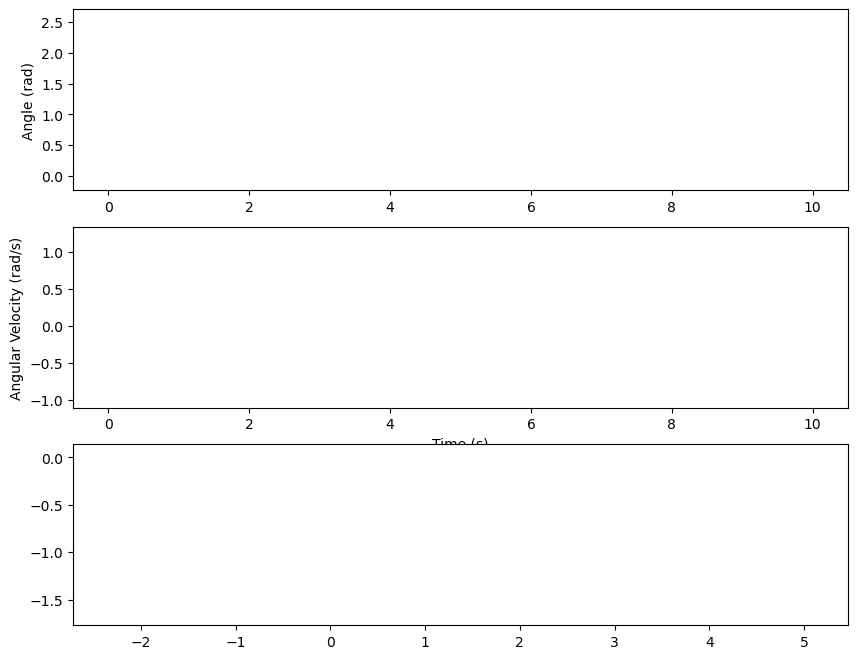

In [107]:
# Visualization using celluloid

fig, ax = plt.subplots(3, 1, figsize=(10, 8))
camera = Camera(fig)

ax[2].set_xlim(-2 * (l1 + l2/2), 2 * (l1 + l2/2))
ax[2].set_ylim(-2 * (l1 + l2/2), 2 * (l1 + l2/2))

for i in range(len(time)):
    θ1, θ2, θ1_dot, θ2_dot = x_log[i]
    x1, y1 = l1 * cos(θ1), -l1 * sin(θ1)
    x2, y2 = x1 + l2 * cos(θ2), y1 - l2 * sin(θ2)
    
    # Draw the angle and angular velocity
    ax[0].plot(time[:i+1], x_log[:i+1, 0], 'b')
    ax[0].plot(time[:i+1], x_log[:i+1, 1], 'r')
    ax[0].set_ylabel('Angle (rad)')

    ax[1].plot(time[:i+1], x_log[:i+1, 2], 'b')
    ax[1].plot(time[:i+1], x_log[:i+1, 3], 'r')
    ax[1].set_xlabel('Time (s)')
    ax[1].set_ylabel('Angular Velocity (rad/s)')

    
    # Add the values of theta 1 and theta 2 as text
    ax[2].text(0, 0, f"θ1: {θ1*180/3.14:.2f}, θ2: {θ2*180/3.14:.2f}", fontsize=12)
    
    # Draw the arrow at the midpoint of the second pendulum arm
    arrow_x, arrow_y = (x1 + x2) / 2, (y1 + y2) / 2
    ax[2].quiver(arrow_x, arrow_y, -sin(θ2), -cos(θ2), angles='xy', scale_units='xy', scale=2, color='blue')
    ax[2].plot([0, x1, x2], [0, y1, y2], 'ro-', lw=2)
    ax[2].plot(1 , 0, 'ro-', lw=2)

    ax[2].axis('equal')
    camera.snap()

animation = camera.animate()

display(HTML(animation.to_jshtml()))